In [1]:
import numpy as np
from joblib import load

from umap import UMAP
from sklearn.feature_extraction.text import CountVectorizer
from hdbscan import HDBSCAN
from bertopic import BERTopic
from bertopic.representation import MaximalMarginalRelevance
from sklearn.cluster import AgglomerativeClustering, MiniBatchKMeans

from sentence_transformers import SentenceTransformer

from data.preprocess_data import combine_json_to_dataframe

ModuleNotFoundError: No module named 'hdbscan'

In [2]:
# Call the function with the path to the zip file
recipe_data = combine_json_to_dataframe("../data/recipes_raw.zip")

recipe_data.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Index: 124434 entries, p3pKOD6jIHEcjf20CCXohP8uqkG5dGi to 2Q3Zpfgt/PUwn1YABjJ5A9T3ZW8xwVa
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   instructions  124434 non-null  object 
 1   ingredients   124434 non-null  object 
 2   title         124434 non-null  object 
 3   full_text     124434 non-null  object 
 4   num_words     124434 non-null  float64
dtypes: float64(1), object(4)
memory usage: 5.7+ MB


In [19]:
docs = [doc for doc in recipe_data.full_text]

embeddings = load("../embeddings/st_embeddings.joblib")

vectoriser_model = CountVectorizer(stop_words="english")
hdbscan_model = HDBSCAN(min_cluster_size=10, 
                        min_samples = 1, # This to reduce outliers as much as possible
                        cluster_selection_epsilon = 0.1, # Reduce number of clusters
                        metric='euclidean', 
                        prediction_data=True)

sentence_model = SentenceTransformer("all-MiniLM-L12-v2")
sentence_model.max_seq_length = 512

representation_model = MaximalMarginalRelevance(diversity=0.2)

topic_model = BERTopic(
    vectorizer_model=vectoriser_model,
    hdbscan_model = hdbscan_model,
    min_topic_size=20,
    n_gram_range=(1, 2),
    embedding_model=sentence_model, 
    representation_model=representation_model
    )

topics, probs = topic_model.fit_transform(docs, embeddings)

In [20]:
topic_model.get_topic_info()

,Topic,Count,Name
0,-1,5082,-1_chocolate_cake_syrup_egg
1,0,5343,0_chicken_thighs_noodles_cooked
2,1,5225,1_cocktail_vodka_gin_martini
3,2,3227,2_steak_steaks_beef_meat
4,3,3211,3_cookies_cookie_dough_baking
...,...,...,...
916,915,10,915_curls_superfine_thermometers_peaks
917,916,10,916_macadamia_nuts_cornflakes_balls
918,917,10,917_wafers_cookie_wafer_vanilla
919,918,10,918_guinness_stout_beer_chocolate


In [21]:
topic_labels = topic_model.generate_topic_labels(nr_words=5,
                                                 topic_prefix=False,
                                                 separator=", ")

In [23]:
topic_model.set_topic_labels(topic_labels)

In [24]:
topic_model.get_topic_info()

,Topic,Count,Name,CustomName
0,-1,5082,-1_chocolate_cake_syrup_egg,"chocolate, cake, syrup, egg, custard"
1,0,5343,0_chicken_thighs_noodles_cooked,"chicken, thighs, noodles, cooked, soy"
2,1,5225,1_cocktail_vodka_gin_martini,"cocktail, vodka, gin, martini, shake"
3,2,3227,2_steak_steaks_beef_meat,"steak, steaks, beef, meat, rib"
4,3,3211,3_cookies_cookie_dough_baking,"cookies, cookie, dough, baking, chocolate"
...,...,...,...,...
916,915,10,915_curls_superfine_thermometers_peaks,"curls, superfine, thermometers, peaks, whip"
917,916,10,916_macadamia_nuts_cornflakes_balls,"macadamia, nuts, cornflakes, balls, crust"
918,917,10,917_wafers_cookie_wafer_vanilla,"wafers, cookie, wafer, vanilla, sifted"
919,918,10,918_guinness_stout_beer_chocolate,"guinness, stout, beer, chocolate, cakes"


In [26]:
topic_model.get_document_info(docs)

,Document,Topic,Name,CustomName,Top_n_words,Probability,Representative_document
0,Recipe title: Grammie Hamblet's Deviled Crab. ...,5,5_shrimp_crab_crabmeat_crabs,"shrimp, crab, crabmeat, crabs, grits",shrimp - crab - crabmeat - crabs - grits - cak...,1.000000,False
1,Recipe title: Infineon Raceway Baked Beans. In...,13,13_beans_green_haricots_bacon,"beans, green, haricots, bacon, pinto",beans - green - haricots - bacon - pinto - sou...,1.000000,False
2,Recipe title: Southwestern Black Bean Dip. Ing...,620,620_patties_beans_cakes_salsa,"patties, beans, cakes, salsa, tortilla",patties - beans - cakes - salsa - tortilla - c...,0.437236,False
3,Recipe title: Sour Cream Noodle Bake. Ingredie...,277,277_casserole_noodles_pasta_macaroni,"casserole, noodles, pasta, macaroni, tomato",casserole - noodles - pasta - macaroni - tomat...,0.820648,False
4,Recipe title: Sushi Renovation. Ingredients: 1...,159,159_sushi_rice_seaweed_bamboo,"sushi, rice, seaweed, bamboo, cucumber",sushi - rice - seaweed - bamboo - cucumber - j...,1.000000,False
...,...,...,...,...,...,...,...
124429,Recipe title: Thai-Indian Veggie Soup. Ingredi...,0,0_chicken_thighs_noodles_cooked,"chicken, thighs, noodles, cooked, soy",chicken - thighs - noodles - cooked - soy - ma...,1.000000,False
124430,Recipe title: Coconut Milk-Free Panang Curry C...,0,0_chicken_thighs_noodles_cooked,"chicken, thighs, noodles, cooked, soy",chicken - thighs - noodles - cooked - soy - ma...,1.000000,False
124431,Recipe title: Cooked Cold Salad. Ingredients: ...,91,91_sprouts_sprout_bacon_brussel,"sprouts, sprout, bacon, brussel, chestnuts",sprouts - sprout - bacon - brussel - chestnuts...,1.000000,False
124432,Recipe title: Easy Eggnog Creme Brulee. Ingred...,87,87_custards_custard_ramekins_brulee,"custards, custard, ramekins, brulee, yolks",custards - custard - ramekins - brulee - yolks...,1.000000,False


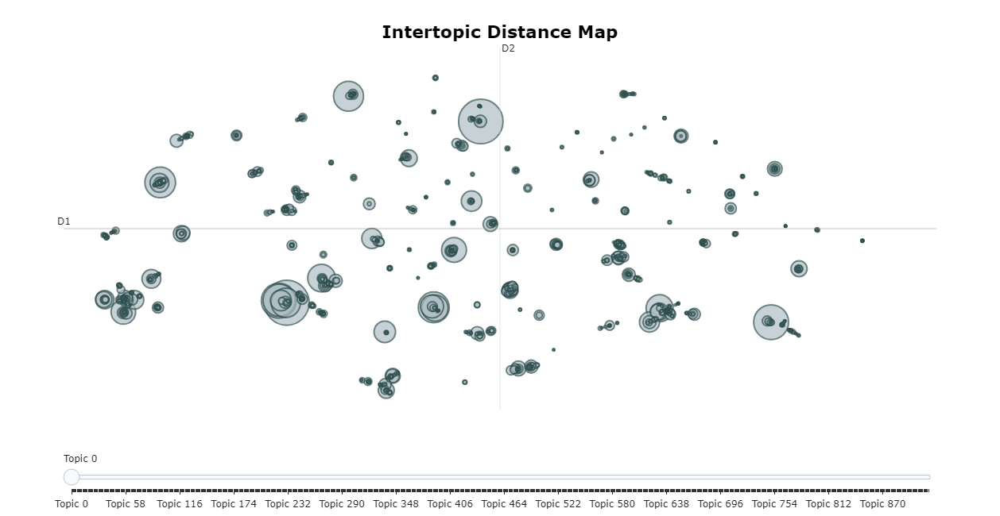

In [29]:
topic_model.visualize_topics()